In [1]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns

In [83]:
df = pd. read_csv("smoking.csv")

In [3]:
df.shape

(55692, 27)

In [4]:
df

,ID,gender,age,height(cm),weight(kg),waist(cm),eyesight(left),eyesight(right),hearing(left),hearing(right),...,hemoglobin,Urine protein,serum creatinine,AST,ALT,Gtp,oral,dental caries,tartar,smoking
0,0,F,40,155,60,81.3,1.2,1.0,1.0,1.0,...,12.9,1.0,0.7,18.0,19.0,27.0,Y,0,Y,0
1,1,F,40,160,60,81.0,0.8,0.6,1.0,1.0,...,12.7,1.0,0.6,22.0,19.0,18.0,Y,0,Y,0
2,2,M,55,170,60,80.0,0.8,0.8,1.0,1.0,...,15.8,1.0,1.0,21.0,16.0,22.0,Y,0,N,1
3,3,M,40,165,70,88.0,1.5,1.5,1.0,1.0,...,14.7,1.0,1.0,19.0,26.0,18.0,Y,0,Y,0
4,4,F,40,155,60,86.0,1.0,1.0,1.0,1.0,...,12.5,1.0,0.6,16.0,14.0,22.0,Y,0,N,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
55687,55676,F,40,170,65,75.0,0.9,0.9,1.0,1.0,...,12.3,1.0,0.6,14.0,7.0,10.0,Y,1,Y,0
55688,55681,F,45,160,50,70.0,1.2,1.2,1.0,1.0,...,14.0,1.0,0.9,20.0,12.0,14.0,Y,0,Y,0
55689,55683,F,55,160,50,68.5,1.0,1.2,1.0,1.0,...,12.4,1.0,0.5,17.0,11.0,12.0,Y,0,N,0
55690,55684,M,60,165,60,78.0,0.8,1.0,1.0,1.0,...,14.4,1.0,0.7,20.0,19.0,18.0,Y,0,N,0


In [5]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 55692 entries, 0 to 55691
Data columns (total 27 columns):
 #   Column               Non-Null Count  Dtype  
---  ------               --------------  -----  
 0   ID                   55692 non-null  int64  
 1   gender               55692 non-null  object 
 2   age                  55692 non-null  int64  
 3   height(cm)           55692 non-null  int64  
 4   weight(kg)           55692 non-null  int64  
 5   waist(cm)            55692 non-null  float64
 6   eyesight(left)       55692 non-null  float64
 7   eyesight(right)      55692 non-null  float64
 8   hearing(left)        55692 non-null  float64
 9   hearing(right)       55692 non-null  float64
 10  systolic             55692 non-null  float64
 11  relaxation           55692 non-null  float64
 12  fasting blood sugar  55692 non-null  float64
 13  Cholesterol          55692 non-null  float64
 14  triglyceride         55692 non-null  float64
 15  HDL                  55692 non-null 

In [7]:
df.describe().T

,count,mean,std,min,25%,50%,75%,max
ID,55692.0,27845.500000,16077.039933,0.0,13922.75,27845.5,41768.25,55691.0
age,55692.0,44.182917,12.071418,20.0,40.00,40.0,55.00,85.0
height(cm),55692.0,164.649321,9.194597,130.0,160.00,165.0,170.00,190.0
weight(kg),55692.0,65.864936,12.820306,30.0,55.00,65.0,75.00,135.0
waist(cm),55692.0,82.046418,9.274223,51.0,76.00,82.0,88.00,129.0
eyesight(left),55692.0,1.012623,0.486873,0.1,0.80,1.0,1.20,9.9
eyesight(right),55692.0,1.007443,0.485964,0.1,0.80,1.0,1.20,9.9
hearing(left),55692.0,1.025587,0.157902,1.0,1.00,1.0,1.00,2.0
hearing(right),55692.0,1.026144,0.159564,1.0,1.00,1.0,1.00,2.0
systolic,55692.0,121.494218,13.675989,71.0,112.00,120.0,130.00,240.0


 # Pandas Profiling

In [9]:
from pandas_profiling import ProfileReport

In [11]:
profile = ProfileReport(df)
profile.to_notebook_iframe()

Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

In [12]:
from pycaret.classification import *

In [13]:
s = setup(df, target = 'smoking', session_id = 10)

,Description,Value
0,Session id,10
1,Target,smoking
2,Target type,Binary
3,Original data shape,"(55692, 27)"
4,Transformed data shape,"(55692, 27)"
5,Transformed train set shape,"(38984, 27)"
6,Transformed test set shape,"(16708, 27)"
7,Ordinal features,2
8,Numeric features,23
9,Categorical features,3


In [14]:
best = compare_models()

,Model,Accuracy,AUC,Recall,Prec.,F1,Kappa,MCC,TT (Sec)
rf,Random Forest Classifier,0.8129,0.8976,0.7641,0.7363,0.7499,0.6005,0.6008,3.0950
et,Extra Trees Classifier,0.8113,0.9006,0.7790,0.7269,0.7520,0.6001,0.6010,2.5670
catboost,CatBoost Classifier,0.7798,0.8609,0.7243,0.6912,0.7073,0.5310,0.5315,6.4590
xgboost,Extreme Gradient Boosting,0.7751,0.8571,0.7161,0.6857,0.7004,0.5205,0.5210,2.7810
lightgbm,Light Gradient Boosting Machine,0.7716,0.8546,0.7231,0.6770,0.6993,0.5155,0.5163,1.0130
gbc,Gradient Boosting Classifier,0.7623,0.8461,0.7170,0.6633,0.6890,0.4972,0.4983,4.0540
ada,Ada Boost Classifier,0.7590,0.8418,0.7109,0.6595,0.6842,0.4898,0.4908,1.2680
dt,Decision Tree Classifier,0.7525,0.7343,0.6656,0.6623,0.6639,0.4680,0.4681,0.5280
ridge,Ridge Classifier,0.7437,0.0000,0.7356,0.6293,0.6782,0.4674,0.4714,0.2680
lda,Linear Discriminant Analysis,0.7430,0.8279,0.7515,0.6249,0.6823,0.4696,0.4753,0.3170


Processing:   0%|          | 0/69 [00:00<?, ?it/s]

# By Pycaret library we can see Random Forest Classifier is Performing Well on the dataset.

# Exploratory Data Analysis

In [15]:
df.isnull().sum()

ID                     0
gender                 0
age                    0
height(cm)             0
weight(kg)             0
waist(cm)              0
eyesight(left)         0
eyesight(right)        0
hearing(left)          0
hearing(right)         0
systolic               0
relaxation             0
fasting blood sugar    0
Cholesterol            0
triglyceride           0
HDL                    0
LDL                    0
hemoglobin             0
Urine protein          0
serum creatinine       0
AST                    0
ALT                    0
Gtp                    0
oral                   0
dental caries          0
tartar                 0
smoking                0
dtype: int64

In [17]:
df.shape

(55692, 27)

In [18]:
df.duplicated().sum()

0

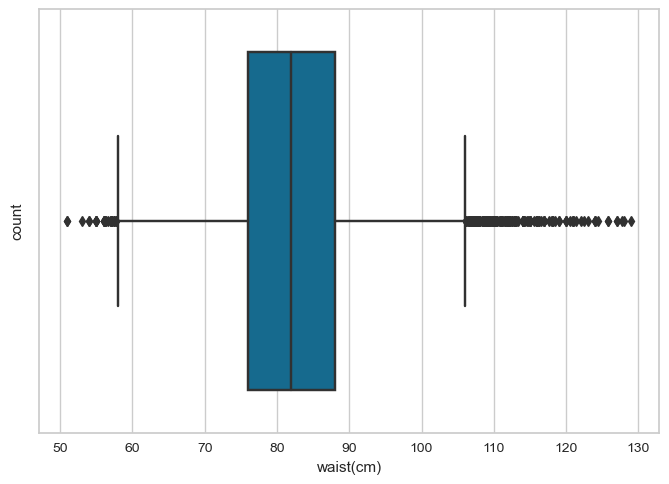

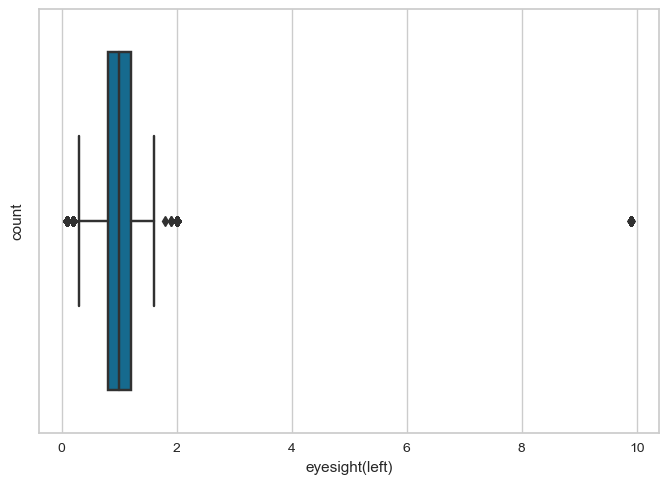

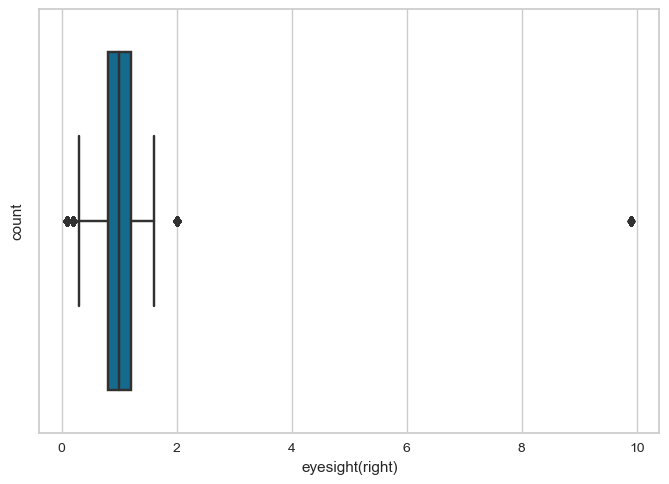

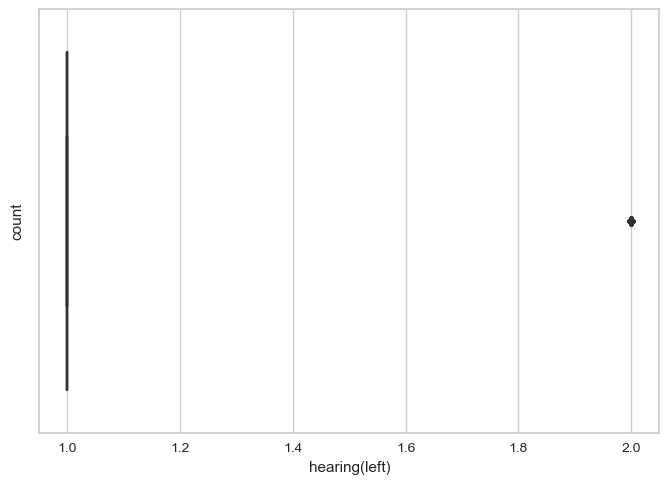

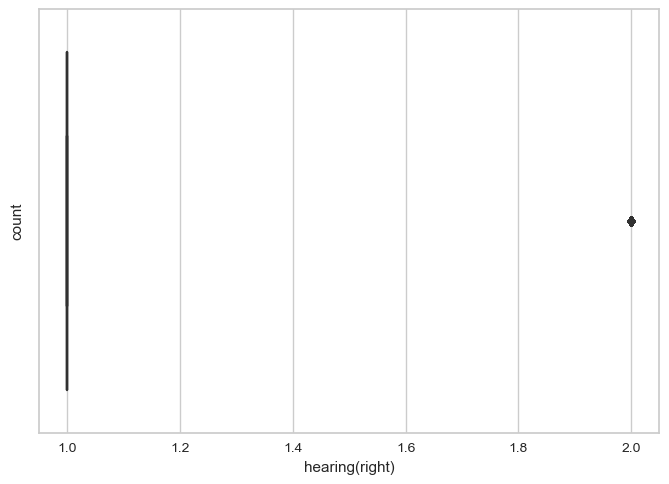

...

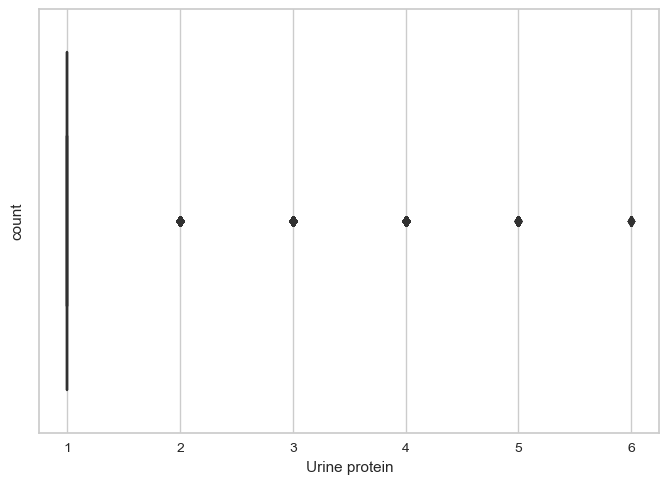

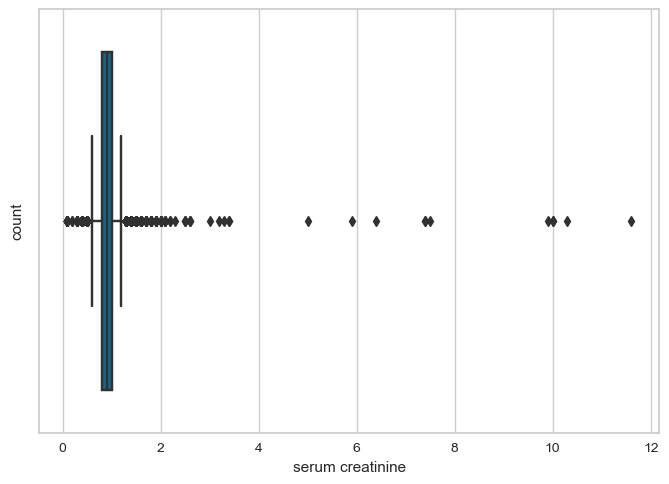

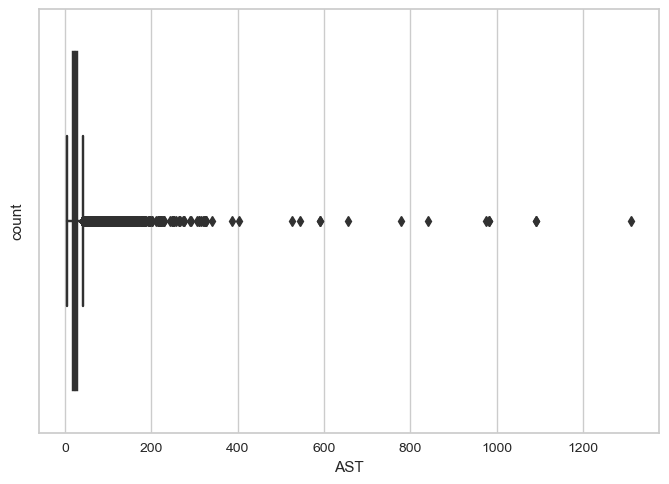

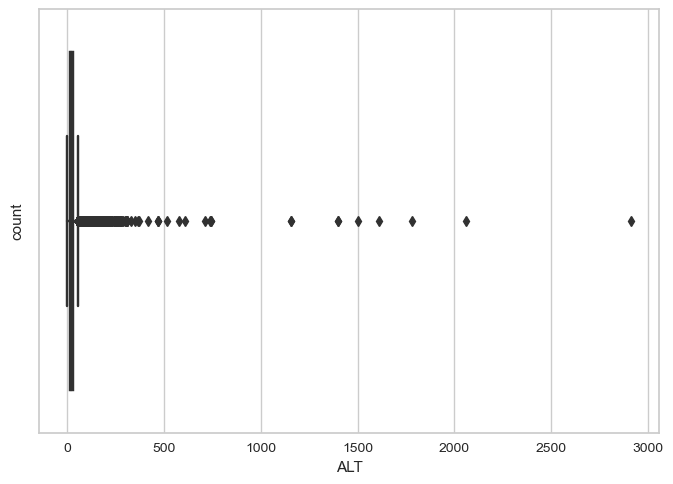

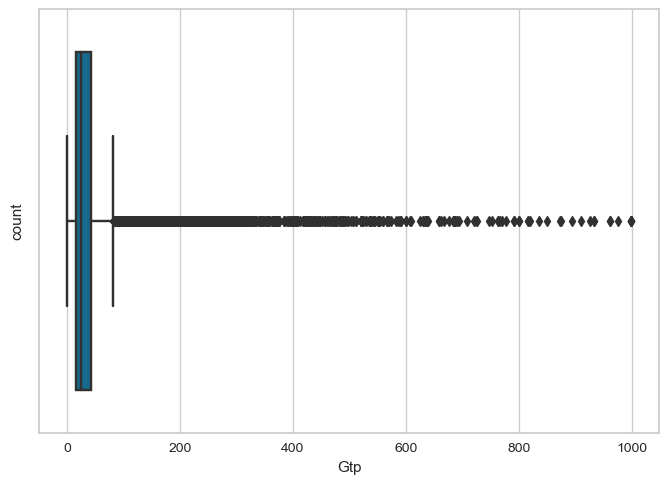

In [21]:
for col in df.columns:
    if df[col].dtypes == int or df[col].dtypes == float:
        sns.boxplot(df[col])
        plt.xlabel(col)
        plt.ylabel('count')
        plt.show()

### There is outliers in the dataset

In [84]:
for col in df.columns:
    if df[col].dtypes == int or df[col].dtypes == float:
        Q1 = df[col].quantile(0.25)
        Q3 = df[col].quantile(0.75)
        IQR = Q3 - Q1
        df = df[(df[col]>= Q1-1.5*IQR) & (df[col]<= Q3 + 1.5*IQR)]

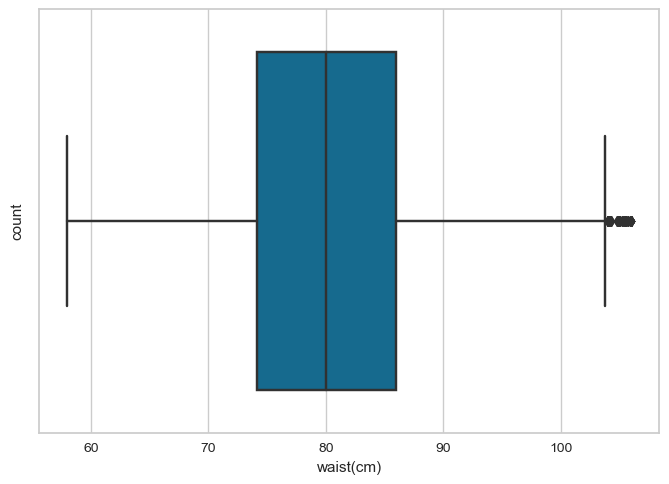

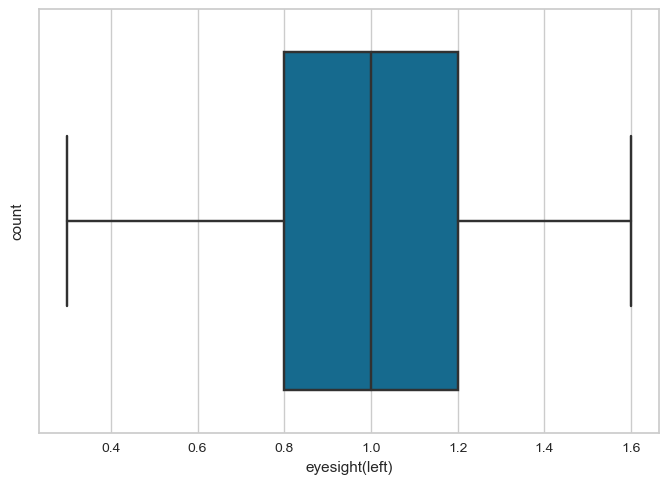

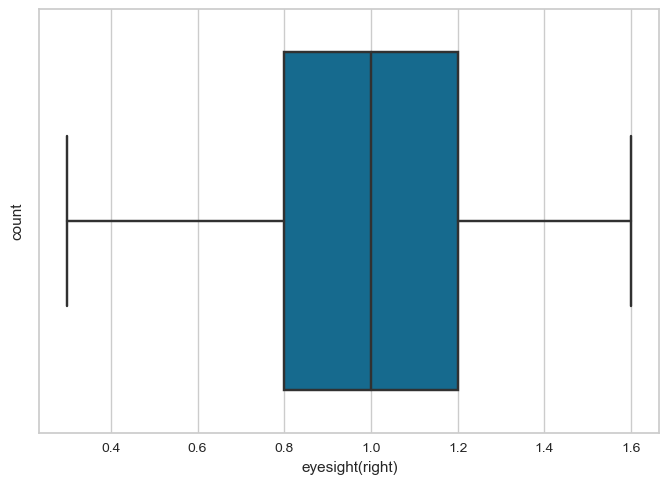

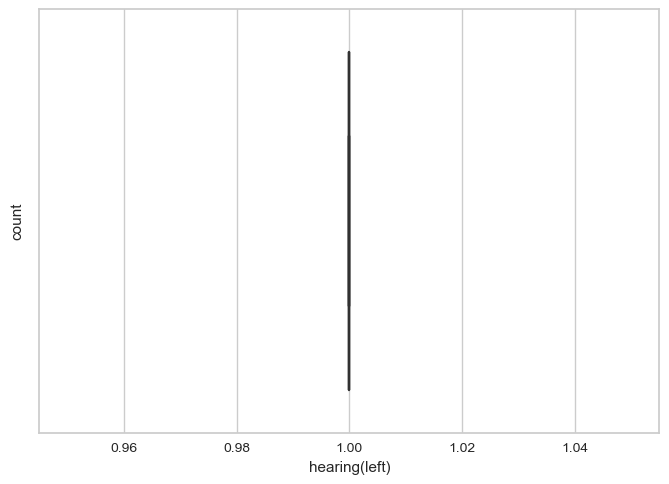

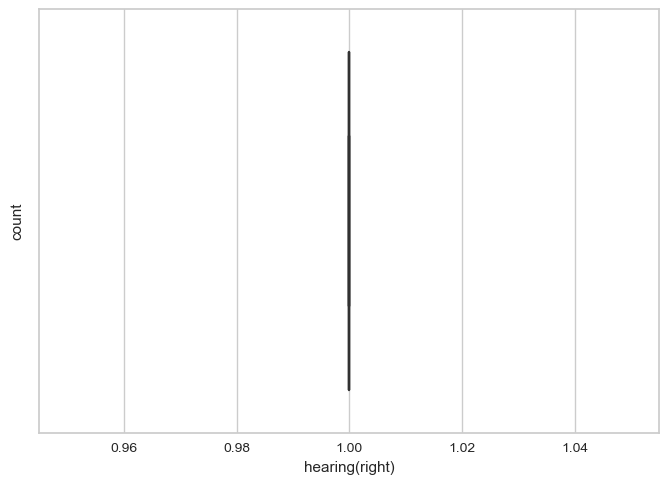

...

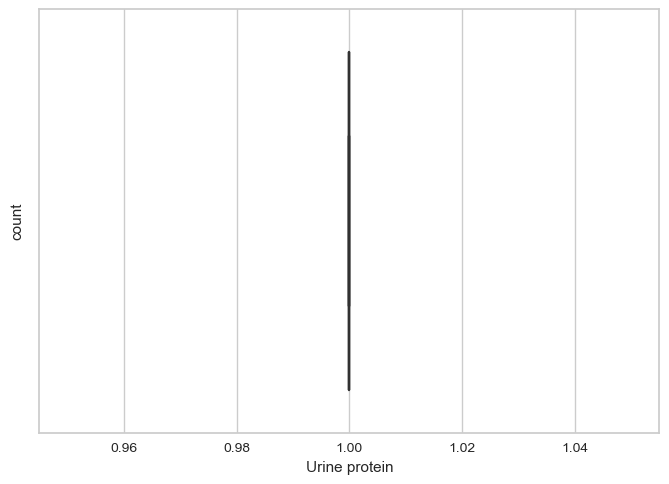

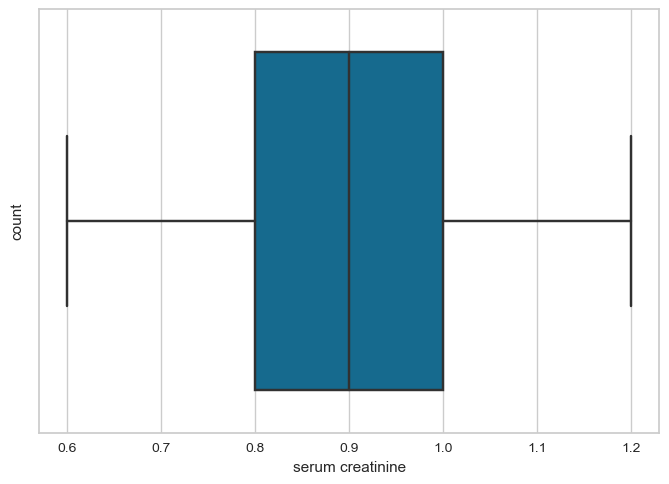

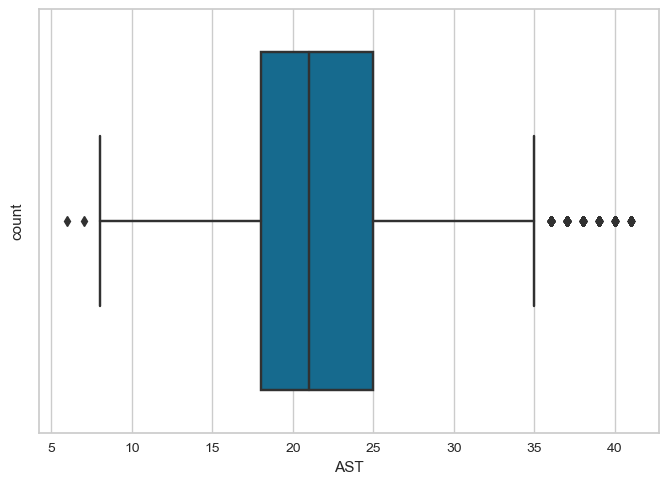

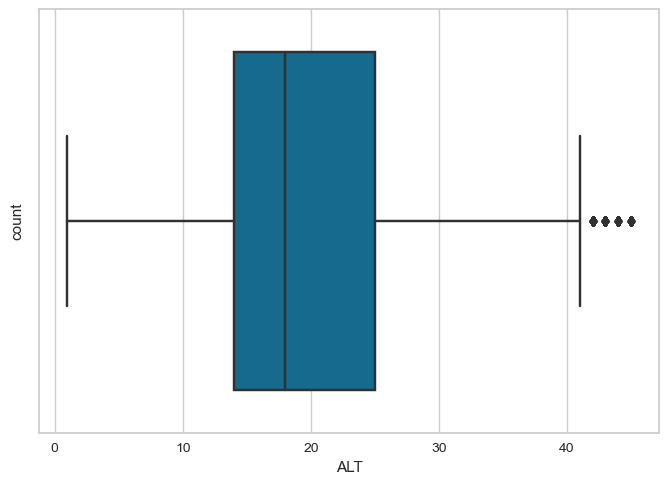

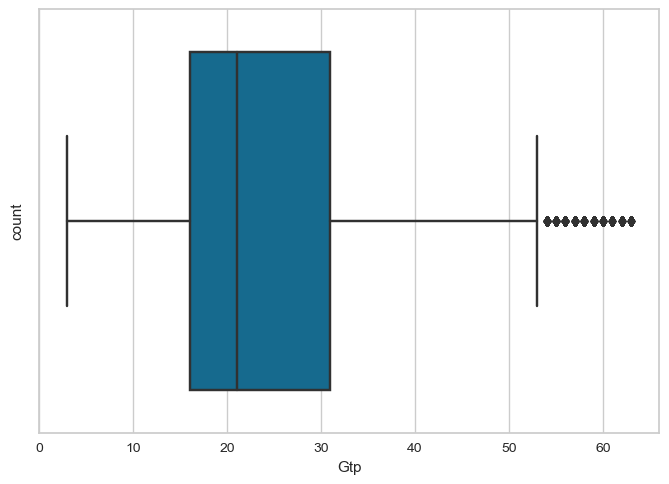

In [23]:
for col in df.columns:
    if df[col].dtypes == int or df[col].dtypes == float:
        sns.boxplot(df[col])
        plt.xlabel(col)
        plt.ylabel('count')
        plt.show()

## Outliers Removed, There is still outliers but we will not removing anymore otherwise we won't we getting good model

In [28]:
df.smoking.value_counts()

0    21524
1    10200
Name: smoking, dtype: int64

## We can clearly see that the target column is unbalanced, we will use SMOTE to make our target column balanced

In [29]:
df.shape

(31724, 27)

##### By Removing outliers we can see there is decrease in the dataset, like our dataset get reduced 
55692 - 31724

In [30]:
55692 - 31724

23968

###### We lost 23968 rows of data

In [33]:
# from imblearn.over_sampling import SMOTE

# # Oversample our dataset using SMOTE to deal with class imbalance
# oversample = SMOTE(sampling_strategy=0.5, random_state=42)
# df = oversample.fit_resample(df)

##### But before performing SMOTE we need to split our data because model is asking x and y so we will first split the data then we will perform both OnehotEncoder and SMOTE 

In [88]:
x = df.iloc[:,:-1]
x

,ID,gender,age,height(cm),weight(kg),waist(cm),eyesight(left),eyesight(right),hearing(left),hearing(right),...,LDL,hemoglobin,Urine protein,serum creatinine,AST,ALT,Gtp,oral,dental caries,tartar
0,0,0,40,155,60,81.3,1.2,1.0,1.0,1.0,...,126.0,12.9,1.0,0.7,18.0,19.0,27.0,1,0,1
2,2,1,55,170,60,80.0,0.8,0.8,1.0,1.0,...,151.0,15.8,1.0,1.0,21.0,16.0,22.0,1,0,0
4,4,0,40,155,60,86.0,1.0,1.0,1.0,1.0,...,107.0,12.5,1.0,0.6,16.0,14.0,22.0,1,0,0
5,5,1,30,180,75,85.0,1.2,1.2,1.0,1.0,...,129.0,16.2,1.0,1.2,18.0,27.0,33.0,1,0,1
6,6,1,40,160,60,85.5,1.0,1.0,1.0,1.0,...,157.0,17.0,1.0,0.7,21.0,27.0,39.0,1,1,1
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
55686,55673,0,60,150,50,75.0,1.0,1.2,1.0,1.0,...,116.0,12.6,1.0,0.8,26.0,21.0,14.0,1,0,1
55687,55676,0,40,170,65,75.0,0.9,0.9,1.0,1.0,...,118.0,12.3,1.0,0.6,14.0,7.0,10.0,1,1,1
55688,55681,0,45,160,50,70.0,1.2,1.2,1.0,1.0,...,79.0,14.0,1.0,0.9,20.0,12.0,14.0,1,0,1
55690,55684,1,60,165,60,78.0,0.8,1.0,1.0,1.0,...,146.0,14.4,1.0,0.7,20.0,19.0,18.0,1,0,0


In [89]:
y = df['smoking']
y

0        0
2        1
4        0
5        0
6        1
        ..
55686    0
55687    0
55688    0
55690    0
55691    1
Name: smoking, Length: 31724, dtype: int64

###### Now Performing OneHotEncoding

In [40]:
df.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 31724 entries, 0 to 55691
Data columns (total 27 columns):
 #   Column               Non-Null Count  Dtype  
---  ------               --------------  -----  
 0   ID                   31724 non-null  int64  
 1   gender               31724 non-null  object 
 2   age                  31724 non-null  int64  
 3   height(cm)           31724 non-null  int64  
 4   weight(kg)           31724 non-null  int64  
 5   waist(cm)            31724 non-null  float64
 6   eyesight(left)       31724 non-null  float64
 7   eyesight(right)      31724 non-null  float64
 8   hearing(left)        31724 non-null  float64
 9   hearing(right)       31724 non-null  float64
 10  systolic             31724 non-null  float64
 11  relaxation           31724 non-null  float64
 12  fasting blood sugar  31724 non-null  float64
 13  Cholesterol          31724 non-null  float64
 14  triglyceride         31724 non-null  float64
 15  HDL                  31724 non-null 

In [45]:
from sklearn.preprocessing import OneHotEncoder

col = ['gender', 'oral', 'tartar']


OH_encoder = OneHotEncoder(handle_unknown='ignore', sparse=False)
OH_cols = pd.DataFrame(OH_encoder.fit_transform(x[col]))

# Generate column names for the one-hot encoded features
feature_names = []
for i, feature in enumerate(col):
    feature_names.extend(OH_encoder.categories_[i])

# Replace default column names with more descriptive ones
OH_cols.columns = feature_names

# One-hot encoding removed index; put it back
OH_cols.index = x.index

# Remove categorical columns (will replace with one-hot encoding)
x.drop(col, axis=1, inplace=True)

# Add one-hot encoded columns to numerical features
x = pd.concat([x, OH_cols], axis=1)
    

##### OneHotEncoding doesn't works for me so I used pd.get_dummies

In [47]:
col = ['gender', 'oral', 'tartar']
OH_encoded_data = pd.get_dummies(df, columns=col)
OH_encoded_data

,ID,age,height(cm),weight(kg),waist(cm),eyesight(left),eyesight(right),hearing(left),hearing(right),systolic,...,AST,ALT,Gtp,dental caries,smoking,gender_F,gender_M,oral_Y,tartar_N,tartar_Y
0,0,40,155,60,81.3,1.2,1.0,1.0,1.0,114.0,...,18.0,19.0,27.0,0,0,1,0,1,0,1
2,2,55,170,60,80.0,0.8,0.8,1.0,1.0,138.0,...,21.0,16.0,22.0,0,1,0,1,1,1,0
4,4,40,155,60,86.0,1.0,1.0,1.0,1.0,120.0,...,16.0,14.0,22.0,0,0,1,0,1,1,0
5,5,30,180,75,85.0,1.2,1.2,1.0,1.0,128.0,...,18.0,27.0,33.0,0,0,0,1,1,0,1
6,6,40,160,60,85.5,1.0,1.0,1.0,1.0,116.0,...,21.0,27.0,39.0,1,1,0,1,1,0,1
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
55686,55673,60,150,50,75.0,1.0,1.2,1.0,1.0,102.0,...,26.0,21.0,14.0,0,0,1,0,1,0,1
55687,55676,40,170,65,75.0,0.9,0.9,1.0,1.0,110.0,...,14.0,7.0,10.0,1,0,1,0,1,0,1
55688,55681,45,160,50,70.0,1.2,1.2,1.0,1.0,101.0,...,20.0,12.0,14.0,0,0,1,0,1,0,1
55690,55684,60,165,60,78.0,0.8,1.0,1.0,1.0,133.0,...,20.0,19.0,18.0,0,0,0,1,1,1,0


In [48]:
df

,ID,gender,age,height(cm),weight(kg),waist(cm),eyesight(left),eyesight(right),hearing(left),hearing(right),...,hemoglobin,Urine protein,serum creatinine,AST,ALT,Gtp,oral,dental caries,tartar,smoking
0,0,F,40,155,60,81.3,1.2,1.0,1.0,1.0,...,12.9,1.0,0.7,18.0,19.0,27.0,Y,0,Y,0
2,2,M,55,170,60,80.0,0.8,0.8,1.0,1.0,...,15.8,1.0,1.0,21.0,16.0,22.0,Y,0,N,1
4,4,F,40,155,60,86.0,1.0,1.0,1.0,1.0,...,12.5,1.0,0.6,16.0,14.0,22.0,Y,0,N,0
5,5,M,30,180,75,85.0,1.2,1.2,1.0,1.0,...,16.2,1.0,1.2,18.0,27.0,33.0,Y,0,Y,0
6,6,M,40,160,60,85.5,1.0,1.0,1.0,1.0,...,17.0,1.0,0.7,21.0,27.0,39.0,Y,1,Y,1
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
55686,55673,F,60,150,50,75.0,1.0,1.2,1.0,1.0,...,12.6,1.0,0.8,26.0,21.0,14.0,Y,0,Y,0
55687,55676,F,40,170,65,75.0,0.9,0.9,1.0,1.0,...,12.3,1.0,0.6,14.0,7.0,10.0,Y,1,Y,0
55688,55681,F,45,160,50,70.0,1.2,1.2,1.0,1.0,...,14.0,1.0,0.9,20.0,12.0,14.0,Y,0,Y,0
55690,55684,M,60,165,60,78.0,0.8,1.0,1.0,1.0,...,14.4,1.0,0.7,20.0,19.0,18.0,Y,0,N,0


In [49]:
df.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 31724 entries, 0 to 55691
Data columns (total 27 columns):
 #   Column               Non-Null Count  Dtype  
---  ------               --------------  -----  
 0   ID                   31724 non-null  int64  
 1   gender               31724 non-null  object 
 2   age                  31724 non-null  int64  
 3   height(cm)           31724 non-null  int64  
 4   weight(kg)           31724 non-null  int64  
 5   waist(cm)            31724 non-null  float64
 6   eyesight(left)       31724 non-null  float64
 7   eyesight(right)      31724 non-null  float64
 8   hearing(left)        31724 non-null  float64
 9   hearing(right)       31724 non-null  float64
 10  systolic             31724 non-null  float64
 11  relaxation           31724 non-null  float64
 12  fasting blood sugar  31724 non-null  float64
 13  Cholesterol          31724 non-null  float64
 14  triglyceride         31724 non-null  float64
 15  HDL                  31724 non-null 

In [51]:
df.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 31724 entries, 0 to 55691
Data columns (total 27 columns):
 #   Column               Non-Null Count  Dtype  
---  ------               --------------  -----  
 0   ID                   31724 non-null  int64  
 1   gender               31724 non-null  object 
 2   age                  31724 non-null  int64  
 3   height(cm)           31724 non-null  int64  
 4   weight(kg)           31724 non-null  int64  
 5   waist(cm)            31724 non-null  float64
 6   eyesight(left)       31724 non-null  float64
 7   eyesight(right)      31724 non-null  float64
 8   hearing(left)        31724 non-null  float64
 9   hearing(right)       31724 non-null  float64
 10  systolic             31724 non-null  float64
 11  relaxation           31724 non-null  float64
 12  fasting blood sugar  31724 non-null  float64
 13  Cholesterol          31724 non-null  float64
 14  triglyceride         31724 non-null  float64
 15  HDL                  31724 non-null 

In [85]:
df['gender'] = np.where(df['gender'] == 'M', 1, 0 ) #converting Male to 1 and Female to 0
df['gender'] = df['gender'].astype(int)

In [55]:
df.oral.value_counts()

Y    31724
Name: oral, dtype: int64

In [86]:
df['oral'] = np.where(df['oral'] == 'Y', 1, 0 ) #converting Y to 1
df['oral'] = df['oral'].astype(int)

In [57]:
df.tartar.value_counts()

Y    17512
N    14212
Name: tartar, dtype: int64

In [87]:
df['tartar'] = np.where(df['tartar'] == 'Y', 1, 0 ) #converting Y to 1 and N to 0
df['tartar'] = df['tartar'].astype(int)

In [72]:
df.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 31724 entries, 0 to 55691
Data columns (total 27 columns):
 #   Column               Non-Null Count  Dtype  
---  ------               --------------  -----  
 0   ID                   31724 non-null  int64  
 1   gender               31724 non-null  int32  
 2   age                  31724 non-null  int64  
 3   height(cm)           31724 non-null  int64  
 4   weight(kg)           31724 non-null  int64  
 5   waist(cm)            31724 non-null  float64
 6   eyesight(left)       31724 non-null  float64
 7   eyesight(right)      31724 non-null  float64
 8   hearing(left)        31724 non-null  float64
 9   hearing(right)       31724 non-null  float64
 10  systolic             31724 non-null  float64
 11  relaxation           31724 non-null  float64
 12  fasting blood sugar  31724 non-null  float64
 13  Cholesterol          31724 non-null  float64
 14  triglyceride         31724 non-null  float64
 15  HDL                  31724 non-null 

#### Now, My every columns is of type integer

###  Now will perform SMOTE

In [74]:
df

,ID,gender,age,height(cm),weight(kg),waist(cm),eyesight(left),eyesight(right),hearing(left),hearing(right),...,hemoglobin,Urine protein,serum creatinine,AST,ALT,Gtp,oral,dental caries,tartar,smoking
0,0,0,40,155,60,81.3,1.2,1.0,1.0,1.0,...,12.9,1.0,0.7,18.0,19.0,27.0,1,0,1,0
2,2,1,55,170,60,80.0,0.8,0.8,1.0,1.0,...,15.8,1.0,1.0,21.0,16.0,22.0,1,0,0,1
4,4,0,40,155,60,86.0,1.0,1.0,1.0,1.0,...,12.5,1.0,0.6,16.0,14.0,22.0,1,0,0,0
5,5,1,30,180,75,85.0,1.2,1.2,1.0,1.0,...,16.2,1.0,1.2,18.0,27.0,33.0,1,0,1,0
6,6,1,40,160,60,85.5,1.0,1.0,1.0,1.0,...,17.0,1.0,0.7,21.0,27.0,39.0,1,1,1,1
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
55686,55673,0,60,150,50,75.0,1.0,1.2,1.0,1.0,...,12.6,1.0,0.8,26.0,21.0,14.0,1,0,1,0
55687,55676,0,40,170,65,75.0,0.9,0.9,1.0,1.0,...,12.3,1.0,0.6,14.0,7.0,10.0,1,1,1,0
55688,55681,0,45,160,50,70.0,1.2,1.2,1.0,1.0,...,14.0,1.0,0.9,20.0,12.0,14.0,1,0,1,0
55690,55684,1,60,165,60,78.0,0.8,1.0,1.0,1.0,...,14.4,1.0,0.7,20.0,19.0,18.0,1,0,0,0


In [75]:
x

,ID,gender,age,height(cm),weight(kg),waist(cm),eyesight(left),eyesight(right),hearing(left),hearing(right),...,LDL,hemoglobin,Urine protein,serum creatinine,AST,ALT,Gtp,oral,dental caries,tartar
0,0,F,40,155,60,81.3,1.2,1.0,1.0,1.0,...,126.0,12.9,1.0,0.7,18.0,19.0,27.0,Y,0,Y
2,2,M,55,170,60,80.0,0.8,0.8,1.0,1.0,...,151.0,15.8,1.0,1.0,21.0,16.0,22.0,Y,0,N
4,4,F,40,155,60,86.0,1.0,1.0,1.0,1.0,...,107.0,12.5,1.0,0.6,16.0,14.0,22.0,Y,0,N
5,5,M,30,180,75,85.0,1.2,1.2,1.0,1.0,...,129.0,16.2,1.0,1.2,18.0,27.0,33.0,Y,0,Y
6,6,M,40,160,60,85.5,1.0,1.0,1.0,1.0,...,157.0,17.0,1.0,0.7,21.0,27.0,39.0,Y,1,Y
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
55686,55673,F,60,150,50,75.0,1.0,1.2,1.0,1.0,...,116.0,12.6,1.0,0.8,26.0,21.0,14.0,Y,0,Y
55687,55676,F,40,170,65,75.0,0.9,0.9,1.0,1.0,...,118.0,12.3,1.0,0.6,14.0,7.0,10.0,Y,1,Y
55688,55681,F,45,160,50,70.0,1.2,1.2,1.0,1.0,...,79.0,14.0,1.0,0.9,20.0,12.0,14.0,Y,0,Y
55690,55684,M,60,165,60,78.0,0.8,1.0,1.0,1.0,...,146.0,14.4,1.0,0.7,20.0,19.0,18.0,Y,0,N


In [90]:
from imblearn.over_sampling import SMOTE

# Oversample our dataset using SMOTE to deal with class imbalance
oversample = SMOTE(sampling_strategy=0.5, random_state=42)
x, y = oversample.fit_resample(x, y)

In [79]:
df.shape

(31724, 27)

In [80]:
df.smoking.value_counts()

0    21524
1    10200
Name: smoking, dtype: int64

In [91]:
y.value_counts()

0    21524
1    10762
Name: smoking, dtype: int64

In [64]:
x

,ID,age,height(cm),weight(kg),waist(cm),eyesight(left),eyesight(right),hearing(left),hearing(right),systolic,...,serum creatinine,AST,ALT,Gtp,dental caries,F,M,Y,N,Y
0,0,40,155,60,81.300000,1.200000,1.000000,1.0,1.0,114.000000,...,0.700000,18.000000,19.000000,27.000000,0,1.0,0.0,1.0,0.000000,1.000000
1,2,55,170,60,80.000000,0.800000,0.800000,1.0,1.0,138.000000,...,1.000000,21.000000,16.000000,22.000000,0,0.0,1.0,1.0,1.000000,0.000000
2,4,40,155,60,86.000000,1.000000,1.000000,1.0,1.0,120.000000,...,0.600000,16.000000,14.000000,22.000000,0,1.0,0.0,1.0,1.000000,0.000000
3,5,30,180,75,85.000000,1.200000,1.200000,1.0,1.0,128.000000,...,1.200000,18.000000,27.000000,33.000000,0,0.0,1.0,1.0,0.000000,1.000000
4,6,40,160,60,85.500000,1.000000,1.000000,1.0,1.0,116.000000,...,0.700000,21.000000,27.000000,39.000000,1,0.0,1.0,1.0,0.000000,1.000000
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
32281,1132,47,165,52,77.969557,0.860655,0.948478,1.0,1.0,123.213103,...,0.948478,19.545665,14.091330,21.363005,0,0.0,1.0,1.0,1.000000,0.000000
32282,44589,29,167,67,82.607813,0.897508,1.102492,1.0,1.0,135.437712,...,0.851246,23.362966,24.487542,41.362966,0,0.0,1.0,1.0,0.000000,1.000000
32283,52775,38,173,64,74.641930,1.051663,1.129157,1.0,1.0,112.317113,...,0.825831,30.125304,36.767234,22.191809,0,0.0,1.0,1.0,0.741687,0.258313
32284,31411,39,158,60,85.590767,1.319308,0.969885,1.0,1.0,129.301154,...,0.860231,22.915004,31.193075,39.397692,0,0.0,1.0,1.0,0.301154,0.698846


In [92]:
y

0        0
1        1
2        0
3        0
4        1
        ..
32281    1
32282    1
32283    1
32284    1
32285    1
Name: smoking, Length: 32286, dtype: int64

### Standard Scaler

In [94]:
from sklearn.model_selection import train_test_split
x_train, x_test, y_train, y_test = train_test_split(x, y, train_size = 0.8, random_state = 30)

In [95]:
from sklearn.preprocessing import StandardScaler
sc = StandardScaler()
scaled_x = sc.fit_transform(x)

## Now, we are done with EDA we will move forward with model making

# As we already saw, RandomForestClassifier will be good model with this dataset we will plot some more classifier model and check for accuracy manually

In [97]:
from sklearn.linear_model import LogisticRegression
from sklearn.metrics import accuracy_score
lr = LogisticRegression()
lr.fit(x_train, y_train )
y_pred = lr.predict(x_test)
lr_accs = accuracy_score(y_pred, y_test)
print(lr_accs)

0.7192629296995974


In [98]:
from sklearn.tree import DecisionTreeClassifier
dt = DecisionTreeClassifier()
dt.fit(x_train, y_train)
y_pred = dt.predict(x_test)
dt_accs = accuracy_score(y_test, y_pred)
print(dt_accs)

0.7743883555280272


In [99]:
from sklearn.ensemble import RandomForestClassifier
rf = RandomForestClassifier()
rf.fit(x_train, y_train)
y_pred = rf.predict(x_test)
rf_accs = accuracy_score(y_test, y_pred)
print(rf_accs)

0.8422112109012078


# Yeah! We can clearly see our random forest classifier is giving more accuracy among all three classifier algorithm

In [101]:
from sklearn.discriminant_analysis import LinearDiscriminantAnalysis

In [103]:
lda = LinearDiscriminantAnalysis()
lda.fit(x_train, y_train)

LinearDiscriminantAnalysis(covariance_estimator=None, n_components=None,
                           priors=None, shrinkage=None, solver='svd',
                           store_covariance=False, tol=0.0001)

In [104]:
lda.transform(x_test)

array([[ 1.01641088],
       [ 0.36336373],
       [ 0.61406934],
       ...,
       [-0.57577789],
       [-1.73233862],
       [ 1.2734998 ]])

In [105]:
lda_coefficients = np.exp(np.abs(lda.coef_))
lda_coefficients = lda_coefficients.flatten()
lda_coefficients

array([ 1.00000056, 13.24830141,  1.00449758,  1.02580554,  1.0096016 ,
        1.01297907,  1.15815065,  1.07416826,  1.        ,  1.        ,
        1.01418722,  1.00543915,  1.00052984,  1.00424434,  1.00380323,
        1.00934328,  1.00820971,  1.16643196,  1.        ,  3.50164101,
        1.01340872,  1.02457884,  1.04157407,  1.        ,  1.3323356 ,
        1.41964604])

In [106]:
features = x.shape[1]
features

26

In [109]:
feature_indices = np.arange(features)
feature_indices

array([ 0,  1,  2,  3,  4,  5,  6,  7,  8,  9, 10, 11, 12, 13, 14, 15, 16,
       17, 18, 19, 20, 21, 22, 23, 24, 25])

In [111]:
feature_names=list(x.columns)

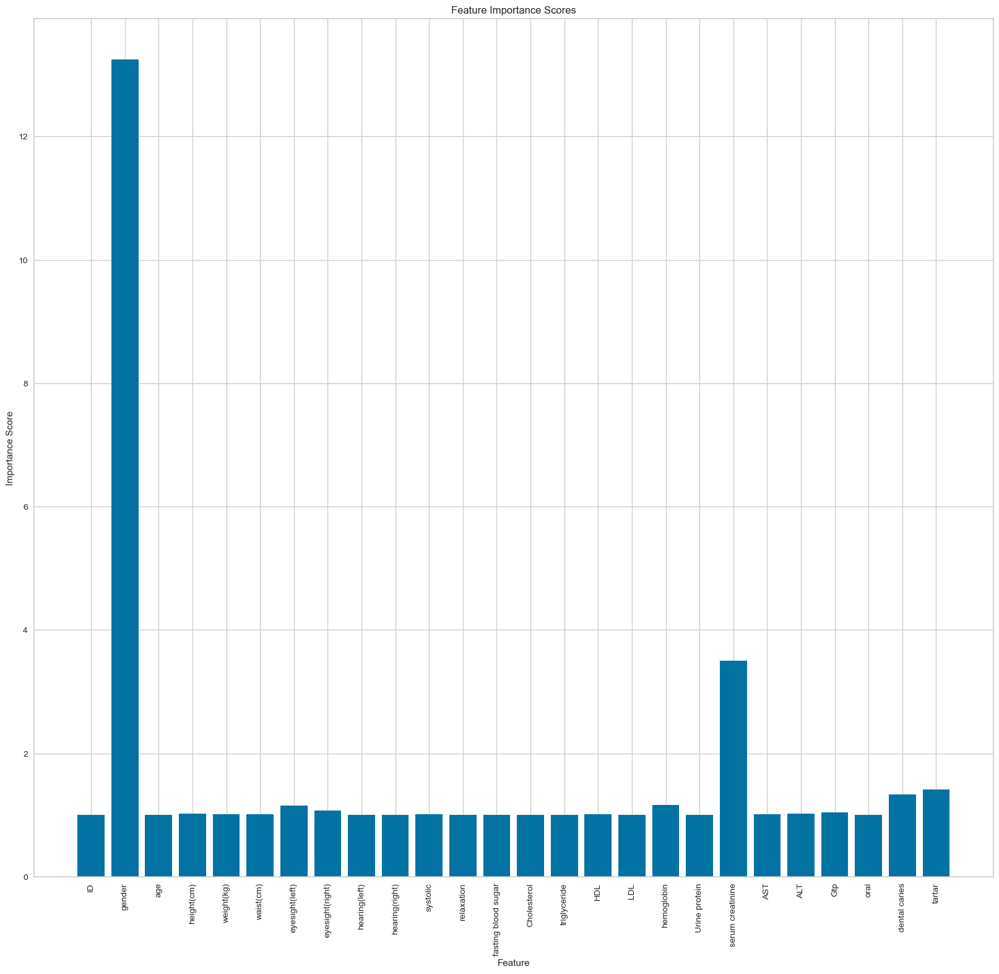

In [112]:
plt.figure(figsize=(20,18))
plt.bar(feature_indices,lda_coefficients)
plt.xticks(feature_indices,feature_names,rotation="vertical")
plt.xlabel('Feature')
plt.ylabel('Importance Score')
plt.title('Feature Importance Scores')
plt.show()

In [113]:
df_feature_score=pd.DataFrame({"Feature_names":feature_names,"feature_scores":lda_coefficients})

In [114]:
top_10_values=df_feature_score.nlargest(10,'feature_scores')

In [115]:
top_10_values

,Feature_names,feature_scores
1,gender,13.248301
19,serum creatinine,3.501641
25,tartar,1.419646
24,dental caries,1.332336
17,hemoglobin,1.166432
6,eyesight(left),1.158151
7,eyesight(right),1.074168
22,Gtp,1.041574
3,height(cm),1.025806
21,ALT,1.024579


In [116]:
top_10_values.index

Int64Index([1, 19, 25, 24, 17, 6, 7, 22, 3, 21], dtype='int64')